In [1]:
using OrdinaryDiffEq, ParameterizedFunctions
using DiffEqSensitivity
using Plots, LaTeXStrings

In [2]:
figdir = "figures/";

## Acute inflammatory response model

**Reynolds et al (2006) [1]**

This is a minimal model for acute immaflatory response. The model includes four variables: pathogen ($P$) activates phagocytes ($N$) which causes inflammation, tissue damage $D$, and trigger anti-inflammatory mediators ($C_A$).

![caption](./figures/09diagram1.png)

The model uses mass action kinetics, Hill-type, and Michaelis-Menten-type terms. It reads
$$
\begin{aligned}
   \frac{d P}{dt} & = k_{pg}P \left(1 - \frac{P}{p_{\infty}}\right) - \frac{k_{pm}s_{m}P}{\mu_{m}+ k_{mp}P} - k_{pn}f(N^*)P, \\ 
   \frac{d N^*}{dt} & = \frac{s_{nr}f(k_{nn}N*+k_{np}P+k_{nd}D)}{\mu_{nr}+f(k_{nn}N*+k_{np}P+k_{nd}D)} - \mu_{n}N* \\ 
   \frac{d D}{dt} & = k_{dn}f_s(f(N^*)) - \mu_{d}D \\ 
   \frac{d C_{A}}{dt} & = s_{c} + \frac{k_{cn}f(N^* + k_{cnd}D)}{1+f(N^* + k_{cnd}D)} - \mu_{c}C_{A}
\end{aligned}
$$

where $f(V) = V/(1+(C_A/c_{\infty})^2)$ and $f_s(V) = V^6/(x_{dn}^6+V^6)$. Parameters are described bellow.


[1]: Reynolds, A., Rubin, J., Clermont, G., Day, J., Vodovotz, Y., & Bard Ermentrout, G. (2006). A reduced mathematical model of the acute inflammatory response: I. Derivation of model and analysis of anti-inflammation. Journal of Theoretical Biology, 242(1), 220–236. https://doi.org/10.1016/j.jtbi.2006.02.016

In [27]:
function model(du, u, p, t)
    P, N, D, C_A = u
    k_pg, P_∞, k_pm, s_m, μ_m, k_mp, k_pn, c_∞, s_nr, k_nn, k_np, k_nd, μ_nr, μ_n,
        k_dn, x_dn, μ_d, s_c, k_cn, k_cnd, μ_c = p
    f(V) = V/(1 + (C_A/c_∞)^2)
    f_s(V) = V^6/(x_dn^6 + V^6)
    R = f(k_nn*N + k_np*P + k_nd*D)
    Q = f(N + k_cnd*D)
    # Inflamatory response
    du[1] = dP = k_pg*P*(1 - P/P_∞) - k_pm*s_m*P/(μ_m + k_mp*P) - k_pn*f(N)*P
    du[2] = dN = s_nr*R/(μ_nr + R) - μ_n*N
    du[3] = dD = k_dn*f_s(f(N)) - μ_d*D
    du[4] = dC_A = s_c + k_cn*Q/(1 + Q) - μ_c*C_A
end

model (generic function with 1 method)

In [28]:
u0 = [
    1.0 # P: Internilized SARS-CoV-2
    0.0 # N: Inflamatory agents
    0.0 # D: Tissue damage
    0.125 # C_A: Anti-inflamatory mediators
]
varnames = [:P :N :D :C_A]
tspan = (0.0, 200.0)
pars = [
    0.3 # k_pg: Growth rate of P
    20 # P_∞: Maximum P population (10^6)
    0.6 # k_pm: Rate at which non-specific local response eliminates P
    0.005 # s_m: Source of non-specific local response
    0.002 # μ_m: Decay rate for the non-specific local response 
    0.01 # k_mp: Rate at which non-specific local response is exhausted by P
    1.8 # k_pn: Rate at which N consumes P
    0.28 # c_∞: Control constant of strength of C_A
    0.08 # s_nr: Source of resting N
    0.01 # k_nn: Activation of resting N by N and their cytokines
    0.1 # k_np: Activation of resting N by P
    0.02 # k_nd: Activation of resting N by D
    0.12 # μ_nr: Decay rate of resti ng N
    0.05 # μ_n: Decay rate of N
    0.35 # k_dn: Maximum rate of D produced by N
    0.06 # x_dn: Level of N for half damage production
    0.02 # μ_d: Decay rate of D
    0.0125 # s_c: Source of C_A
    0.04 # k_cn: Maximum production rate of C_A
    48.0 # k_cnd: Relative effectiveness of N and D in producing C_A
    0.1 # μ_c: Decay rate of C_A
]
pars_ix = (k_pg=1, P_∞=2, k_pm=3, s_m=4, μ_m=5, k_mp=6, k_pn=7, c_∞=8, s_nr=9, k_nn=10,
    k_np=11, k_nd=12, μ_nr=13, μ_n=14, k_dn=15, x_dn=16, μ_d=17, s_c=18, k_cn=19, k_cnd=20,
    μ_c=21);

In [29]:
prob = ODEProblem(model, u0, tspan, pars)

ODEProblem with uType Array{Float64,1} and tType Float64. In-place: true
timespan: (0.0, 200.0)
u0: [1.0, 0.0, 0.0, 0.125]

In [30]:
sol = solve(prob, Tsit5());

This is the healthy outcome (Why?)

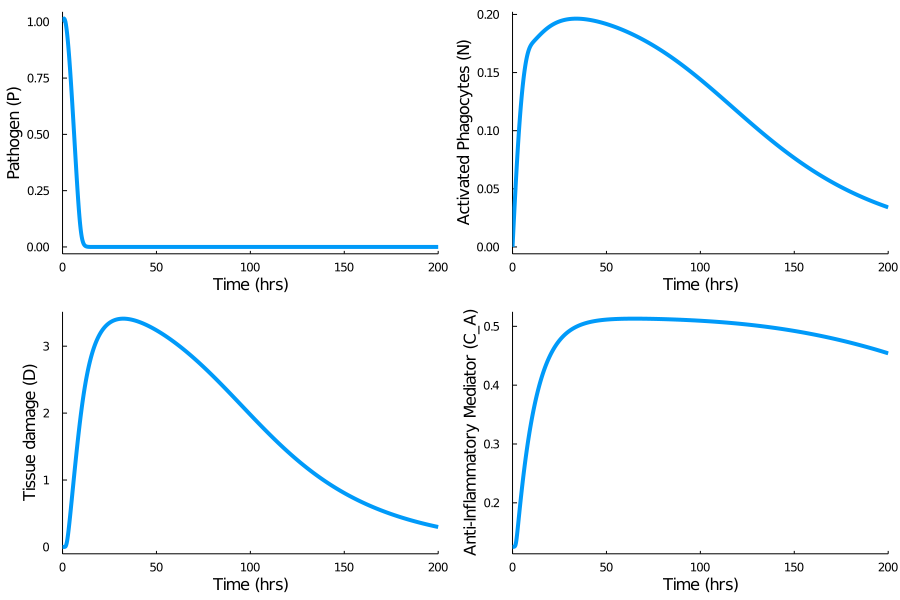

In [31]:
plot(
    plot(sol, vars=(1), yaxis=("Pathogen (P)")),
    plot(sol, vars=(2), yaxis=("Activated Phagocytes (N)")),
    plot(sol, vars=(3), yaxis=("Tissue damage (D)")),
    plot(sol, vars=(4), yaxis=("Anti-Inflammatory Mediator (C_A)")),
    xaxis=("Time (hrs)"),
    layout=4, legend=false, grid=false, lw=4, size=(900,600))

Incresing $k_{pg}$ produces septic death (Why?)

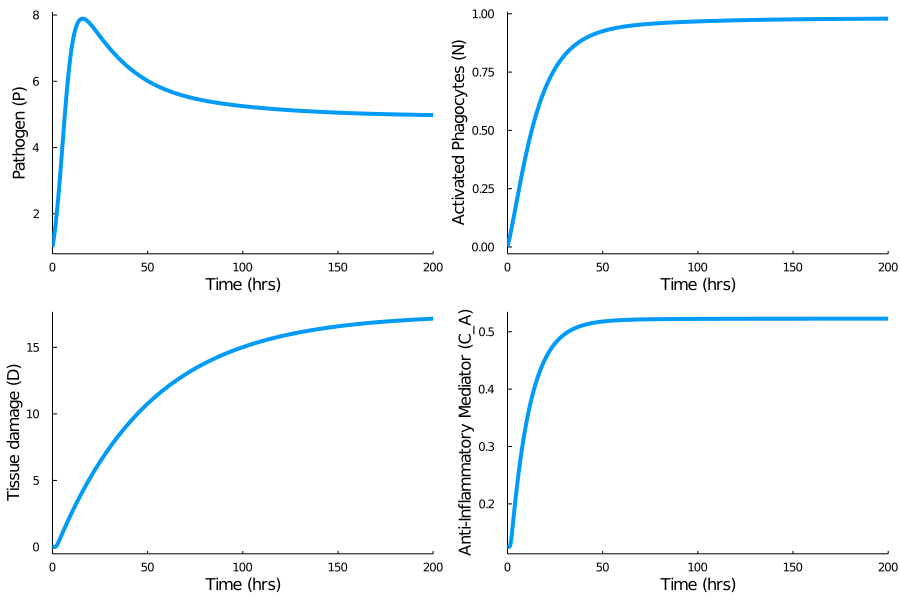

In [32]:
pars[pars_ix.k_pg] = 0.6
prob = ODEProblem(model, u0, tspan, pars)
sol = solve(prob, Tsit5())
plot(
    plot(sol, vars=(1), yaxis=("Pathogen (P)")),
    plot(sol, vars=(2), yaxis=("Activated Phagocytes (N)")),
    plot(sol, vars=(3), yaxis=("Tissue damage (D)")),
    plot(sol, vars=(4), yaxis=("Anti-Inflammatory Mediator (C_A)")),
    xaxis=("Time (hrs)"),
    layout=4, legend=false, grid=false, lw=4, size=(900,600))

### Conclusion

To do

## RAS dynamics

**Leetem Gurley and Layton (2018) [2]**

This is a model for the Renin angiotensin system (RAS) based on the model by Lo et al. [3] and adapted for to study difference between sexes in hypertensive therapy in rats. 

![caption](./figures/09diagram2.png)

It reads
$$
\begin{aligned}
   \frac{d AGT}{dt} & = k_{AGT} - PRA - \frac{ln(2)}{h_{AGT}}[AGT], \\
   \frac{d AngI}{dt} & = PRA - (c_{ACE} + c_{Chym} + c_{NEP})AngI - \frac{ln(2)}{h_{AngI}}[AngI], \\
   \frac{d AngII}{dt} & = (c_{ACE} + c_{Chym})AngI - (c_{ACE2} + c_{AngIIAngIV} + c_{AT1R}+c_{AT2R})AngII - \frac{ln(2)}{h_{AngII}}[AngII], \\
   \frac{d AT1RAngII}{dt} & = c_{AT1R}AngII - \frac{ln(2)}{h_{AT1R}}[AT1RAngII], \\
   \frac{d AT2RAngII}{dt} & = c_{AT2R}AngII - \frac{ln(2)}{h_{AT2R}}[AT2RAngII], \\
   \frac{d Ang17}{dt} & = c_{NEP}AngI + c_{ACE2}AngII - \frac{ln(2)}{h_{Ang17)}}[Ang17], \\
   \frac{d AngIV}{dt} & = c_{AngIIAngIV}AngII - \frac{ln(2)}{h_{AngIV}}[AngIV].\\
\end{aligned}
$$
The model uses linear growth and decay terms, except for the plasma renin activitiy (PRA) which if non-linear Michaelian-like term of the form
$$
PRA = \frac{V_{max}AGT}{AGT+AGT_{EQ}}\left(\frac{AT1RAngII_{EQ}}{AT1RAngII}\right)^{B_{AT1}}.
$$

Half-life parameters values are taken from [4].


[2]: Leete, J., Gurley, S., & Layton, A. T. (2018). Modeling sex differences in the renin angiotensin system and the efficacy of antihypertensive therapies. Computers and Chemical Engineering, 112, 253–264. https://doi.org/10.1016/j.compchemeng.2018.02.009

[3]: Lo, A., Beh, J., De Leon, H., Hallow, M. K., Ramakrishna, R., Rodrigo, M., Sarkar, A., Sarangapani, R., & Georgieva, A. (2011). Using a Systems Biology Approach to Explore Hypotheses Underlying Clinical Diversity of the Renin Angiotensin System and the Response to Antihypertensive Therapies. In AAPS Advances in the Pharmaceutical Sciences Series (Vol. 1, pp. 457–482). https://doi.org/10.1007/978-1-4419-7415-0_20

[4]: Hallow, K. M., Lo, A., Beh, J., Rodrigo, M., Ermakov, S., Friedman, S., de Leon, H., Sarkar, A., Xiong, Y., Sarangapani, R., Schmidt, H., Webb, R., & Kondic, A. G. (2014). A model-based approach to investigating the pathophysiological mechanisms of hypertension and response to antihypertensive therapies: Extending the Guyton model. American Journal of Physiology - Regulatory Integrative and Comparative Physiology, 306(9), 647–662. https://doi.org/10.1152/ajpregu.00039.2013

In [33]:
function model(du, u, p, t)
    AGT, AngI, AngII, AT1RAngII, AT2RAngII, Ang17, AngIV = u
    k_AGT, V_max, AGT_EQ, AT1RAngII_EQ, B_AT1, h_AGT,
        c_ACE, c_Chym, c_NEP, h_AngI,
        c_ACE2, c_AngIIAngIV, c_AT1R, c_AT2R, h_AngII, 
        h_AT1R, h_AT2R, h_Ang17, h_AngIV = p
    PRA = V_max*AGT/(AGT + AGT_EQ)*(AT1RAngII_EQ/AT1RAngII)^B_AT1
    # RAS
    du[1] = dAGT = k_AGT - PRA - log(2.)/h_AGT*AGT
    du[2] = dAngI = PRA - (c_ACE + c_Chym + c_NEP)*AngI - log(2.)/h_AngI*AngI
    du[3] = dAngII = (c_ACE + c_Chym)*AngI - (c_ACE2 + c_AngIIAngIV + c_AT1R + c_AT2R)*AngII - log(2.)/h_AngII*AngII
    du[4] = dAT1AngII = c_AT1R*AngII - log(2.)/h_AT1R*AT1RAngII
    du[5] = dAT2AngII = c_AT2R*AngII - log(2.)/h_AT2R*AT2RAngII
    du[6] = dAng17 = c_NEP*AngI + c_ACE2*AngII - log(2.)/h_Ang17*Ang17
    du[7] = dAngIV = c_AngIIAngIV*AngII - log(2.)/h_AngIV*AngIV
end

model (generic function with 1 method)

Using values to produce the stady state for normotensive males (Table 2 in [2]).

In [34]:
u0 = [
    0.0 # AGT: Angiotensinogen
    1.0 # AngI: Angiotensin I
    1.0 # AngII: Angiotensin II
    1.46 # AT1AngII: Ang II bound to Ang II type 1 receptor (AT1R)
    1.82 # AT2AngII: Ang II bound to Ang II type 2 receptor (AT2R)
    1.0 # Ang17: Angiotensis (1-7)
    1.29 # AngIV: Angiotensin IV
]
varnames = ["AGT" "AngI" "AngII" "AT1RAngII" "AT2RAngII" "Ang17" "AngIV"]
tspan = (0.0, 100.0)
pars = [
    48061.0 # k_AGT:
    16270.4 # V_max:
    576000.0 # AGT_EQ:
    20.46 # AT1RAngII_EQ:
    0.95 # B_AT1: 
    10.0 # h_AGT: Hallow (2014)
    5.81 # c_ACE
    0.65 # c_Chym:
    0.76 # c_NEP
    0.5/60 # h_AngI: Hallow (2014)
    0.16 # c_ACE2:
    17.88 # c_AngIIAngIV:
    11.82 # c_AT1R
    3.94 # c_AT2R
    0.66/60 # h_AngII: Hallow (2014)
    12.0/60 # h_AT1R: Hallow (2014)
    12.0/60 # h_AT2R: Hallow (2014)
    30.0/60 # h_Ang17: Hallow (2014)
    0.5/60 # h_AngIV: Hallow (2014)
]
pars_ix = (k_AGT=1, V_max=2, AGT_EQ=3, AT1RAngII_EQ=4, B_AT1=5, h_AGT=6,
        c_ACE=7, c_Chym=8, c_NEP=9, h_AngI=10,
        c_ACE2=11, c_AngIIAngIV=12, c_AT1R=13, c_AT2R=14, h_AngII=15, 
        h_AT1R=16, h_AT2R=17, h_Ang17=18, h_AngIV=19);

In [35]:
prob = ODEProblem(model, u0, tspan, pars)

ODEProblem with uType Array{Float64,1} and tType Float64. In-place: true
timespan: (0.0, 100.0)
u0: [0.0, 1.0, 1.0, 1.46, 1.82, 1.0, 1.29]

In [36]:
sol = solve(prob, Tsit5());

In [37]:
plot(
    plot(sol, vars=(1), labels=varnames[1]),
    plot(sol, vars=(2:7), labels=varnames[:,2:7]),
    xaxis=("Time (hrs)"),
    layout=2, grid=false, lw=4, size=(900,300)
)

The steady state values match those of Table 1 in [2].

In [38]:
sol[end]

7-element Array{Float64,1}:
 575685.692766055
     89.93766476476588
      6.00149623320791
     20.467326548033935
      6.822442182677976
     49.998468911175685
      1.2898700259391171

Change values to produce the stady state for normotensive females (Table 2 in [2]).

In [39]:
pars[pars_ix.V_max] = 13705.8
pars[pars_ix.k_AGT] = 46778.0
pars[pars_ix.c_ACE] = 6.96
pars[pars_ix.c_Chym] = 0.77
pars[pars_ix.c_NEP] = 0.46
pars[pars_ix.c_ACE2] = 0.026
prob = ODEProblem(model, u0, tspan, pars)
sol = solve(prob, Tsit5())
plot(
    plot(sol, vars=(1), labels=varnames[1]),
    plot(sol, vars=(2:7), labels=varnames[:,2:7]),
    xaxis=("Time (hrs)"), 
    layout=2, grid=false, lw=4, size=(900,300)
)

The steady state values match those of Table 1 in [2]. 

In [16]:
sol[end]

7-element Array{Float64,1}:
 575581.995323462
     75.0013960794148
      5.997664510934309
     20.452289377273342
      6.817429792424448
     24.99967587128665
      1.2885660650674304

Now we try the model in Layton's paper.

## Effect of SARS-CoV-2 and ACE inhbitors in RAS and local inflamation

**Sadria and Layton (2020) [5]**

This model adapts the previous two models and includes the dynamics of ACE and SARS-CoV-2.

![caption](./figures/09diagram3.png)

[5]: Sadria, M., & Layton, A. T. (2020). Use of angiotensin-Converting enzyme inhibitors and angiotensin II receptor blockers during the COVID-19 pandemic: A modeling analysis. PLoS Computational Biology, 16(10), 1–16. https://doi.org/10.1371/journal.pcbi.1008235

In [17]:
function model(du, u, p, t)
    AngI, AngII, AT1RAngII, AT2RAngII, Ang17, ACE2m, ACE2p, ACE2i, P_plasma, P, N, D, C_A = u
    PRA, c_ACE, c_NEP, h_AngI, 
        k_ACE2, c_AT1R, c_AT2R, h_AngII, h_AT1R, h_AT2R, h_Ang17, 
        S_ACE2m, c_ADAM17, c_Cov19, K_mACE2i, c_ACE2i, h_ACE2, 
        k_burst, k_ACE2P, 
        k_Cov19, k_pg, P_∞, k_pm, s_m, μ_m, k_mp, k_pn, c_∞, 
        s_nr, k_nn, k_np, k_nd, μ_nr, k_AT1R, μ_n, 
        k_dn, x_dn, μ_d, 
        s_c, k_cn, k_cnd, k_ACE2p, k_Ang17, k_AT2R, μ_c = p
    f(V) = V/(1 + (C_A/c_∞)^2)
    f_s(V) = V^6/(x_dn^6 + V^6)
    R = f(k_nn*N + k_np*P + k_nd*D)
    Q = f(N + k_cnd*D)
    # RAS    
    du[1] = dAngI = PRA - (c_ACE + c_NEP)*AngI - log(2.)/h_AngI*AngI
    du[2] = dAngII = c_ACE*AngI - k_ACE2*ACE2m*AngII - (c_AT1R + c_AT2R)*AngII - log(2.)/h_AngII*AngII
    du[3] = dAT1AngII = c_AT1R*AngII - log(2.)/h_AT1R*AT1RAngII
    du[4] = dAT2AngII = c_AT2R*AngII - log(2.)/h_AT2R*AT2RAngII
    du[5] = dAng17 = c_NEP*AngI + k_ACE2*ACE2m*AngII - log(2.)*Ang17/h_Ang17
    # ACE
    du[6] = dACE2m = S_ACE2m - (c_ADAM17 + c_AT1R*AT1RAngII +
        c_Cov19*P_plasma/(K_mACE2i + P_plasma + c_ACE2i*ACE2p))*ACE2m - log(2.)/h_ACE2*ACE2m
    du[7] = dACE2p = c_ADAM17*ACE2m - log(2.)/h_ACE2*ACE2p
    du[8] = dACE2i = (c_AT1R*AT1RAngII + c_Cov19*P_plasma/(K_mACE2i + P_plasma + c_ACE2i*ACE2p))*ACE2m -
        log(2.)/h_ACE2*ACE2i
    du[9] = dP_plasma = k_burst*P - k_ACE2P*ACE2p*P_plasma -
        c_Cov19*P_plasma*ACE2m/(K_mACE2i + P_plasma + c_ACE2i*ACE2p)
    # Inflamatory response
    du[10] = dP = k_Cov19*c_Cov19*P_plasma*ACE2m/(K_mACE2i + P_plasma + c_ACE2i*ACE2p) +
        k_pg*P*(1 - P/P_∞) - k_pm*s_m*P/(μ_m + k_mp*P) - k_pn*f(N)*P - k_burst*P
    du[11] = dN = s_nr*R/(μ_nr + R) + k_AT1R*AT1RAngII - μ_n*N
    du[12] = dD = k_dn*f_s(f(N)) - μ_d*D
    du[13] = dC_A = s_c + k_cn*Q/(1 + Q) + k_ACE2p*ACE2p + k_Ang17*Ang17 + k_AT2R*AT2RAngII - μ_c*C_A
end

model (generic function with 1 method)

In [18]:
u0 = [# ICs at steady state
    89.98839987559009  # AngI: Angiotensin I
    6.882112731920312  # AngII: Angiotensin II
    23.451788101920254 # AT1AngII: Ang II bound to Ang II type 1 receptor (AT1R)
    7.737899627537138  # AT2AngII: Ang II bound to Ang II type 2 receptor (AT2R)
    78.1519565316704  # Ang17: Angiotensis (1-7)
    0.940 # ACE2m: Membrane bound ACE2
    0.045 # ACE2p: Plasma ACE2
    0.015 # ACE2i: Internalized ACE2
    0.0 # P_plasma: Plasma SARS-CoV-2
    0.0 # P: Internilized SARS-CoV-2
    0.0 # N: Inflamatory agents
    0.0 # D: tissue damage
    0.0 # C_A: anti-inflamatory mediators
]
varnames = ["AngI" "AngII" "AT1RAngII" "AT2RAngII" "Ang1-7" "ACE2m" "ACE2p" "ACE2i" "P_plasma" "P" "N" "D" "C_A"]
tspan = (0.0, 200.0)
pars = [   
    8135.2 # PRA
    5.81+0.65 # c_ACE
    0.76 # c_NEP
    0.5/60 # h_AngI
    6.18 #? k_ACE2
    11.82 #1.48e-6 # c_AT1R
    3.9 # c_AT2R
    0.66/60 # h_AngII
    12.0/60 # h_AT1R
    12.0/60 # h_AT2R
    30.0/60 # h_Ang17
    1.36e-2 # S_ACE2m
    6.51e-5 # c_ADAM17
    3e-6 # c_Cov19
    1.0 #? K_mACE2i
    1.0 #? c_ACE2i
    8.5 # h_ACE2
    1e-3 # k_burst
    1.0 #? k_ACE2P
    1e3 # k_Cov19
    0.3 # k_pg: Growth rate of P
    20 # P_∞: Maximum P population (10^6)
    0.6 # k_pm: Rate at which non-specific local response eliminates P
    0.005 # s_m: Source of non-specific local response
    0.002 # μ_m: Decay rate for the non-specific local response 
    0.01 # k_mp: Rate at which non-specific local response is exhausted by P
    1.8 # k_pn: Rate at which N consumes P
    0.28 # c_∞: Control constant of strength of C_A
    0.08 # s_nr: Source of resting N
    0.01 # k_nn: Activation of resting N by N and their cytokines
    0.1 # k_np: Activation of resting N by P
    0.02 # k_nd: Activation of resting N by D
    0.12 # μ_nr: Decay rate of resti ng N
    3.5e-3 # k_AT1R
    0.05 # μ_n: Decay rate of N
    0.35 # k_dn: Maximum rate of D produced by N
    0.06 # x_dn: Level of N for half damage production
    0.02 # μ_d: Decay rate of D
    0.0125 # s_c: Source of C_A
    0.04 # k_cn: Maximum production rate of C_A
    48.0 # k_cnd: Relative effectiveness of N and D in producing C_A
    2.1e-2 # k_ACE2p
    1e-2 # k_Ang17
    5.1e-3 # k_AT2R
    0.1 #5.1e-3 # μ_c
];

In [25]:
length(pars)

45

In [19]:
prob = ODEProblem(model, u0, tspan, pars)

ODEProblem with uType Array{Float64,1} and tType Float64. In-place: true
timespan: (0.0, 200.0)
u0: [89.98839987559009, 6.882112731920312, 23.451788101920254, 7.737899627537138, 78.1519565316704, 0.94, 0.045, 0.015, 0.0, 0.0, 0.0, 0.0, 0.0]

In [20]:
sol = solve(prob, Tsit5());

Ang1-7 and ACE2i should be at steady state. What's happenning?

In [21]:
plot(
    plot(sol, vars=(1:5), label=varnames[:,1:5]),
    plot(sol, vars=(6:9), label=varnames[:,6:9]),
    plot(sol, vars=(10:12), label=varnames[:,10:12]),
    plot(sol, vars=(13), label=varnames[13]),
    xaxis=("Time (hrs)"), 
    layout=4, grid=false, lw=4, size=(900,600))

In [22]:
u0 = sol.u[end]

13-element Array{Float64,1}:
 89.99347825998446
  7.383854073659415
 25.182863617042436
  8.309066675673902
 49.338098522009965
  4.590883414778432e-5
  4.018125459769371e-8
  0.16672966652955795
  0.0
  0.0
  1.7633311015938833
  4.6502606811188635e-6
  5.4843977230608125

Change the value of plasma SARS-CoV-2. The plot does not make sense, review terms and parameters.

In [23]:
u0[9] = 0.
prob = ODEProblem(model, u0, tspan, pars)
sol = solve(prob, Tsit5())
plot(
    plot(sol, vars=(12), yaxis=("Tisue damage (D)")),
    plot(sol, vars=(10), yaxis=("Covid-19")),
    plot(sol, vars=(13), yaxis=("Act. phagocyes")),
    xaxis=("Time (hrs)"), legend=false,
    layout=(1,3), grid=false, lw=4, size=(900,300))

## Standard virus load function

The standard virus load function with three main phases given by

$$V(t)=v_1(t)v_2(t)v_3(t),$$

where $v _1$ describes the initial growth phase between $a _1$ and $a _2$ , $v _2$ the intermediate slow decay
phase between $a _2$ and $b _1$, and $v _3$ the final decay phase between $b _1$ and $b _2$. These functions are given as sigmoid and exponential functions, respectively

$$
\begin{aligned}
v_1(t) & = 1 + \frac{V_{\max} - 1}{2} \left[ \tanh \left( \frac{6}{a_2 - a_1} \left( t - \frac{a_1 + a_2}{2} \right) \right) - \tanh  \left( -3\frac{a_2 + a_1}{a_2 - a_1} \right) \right] \\
v_2(t) & = (1 - H(t - a_2)) + H(t - a_2)e^{-\alpha(t - a_2)} \\
v_3(t) & = 1 - \frac{1 - V_{\min}}{2} \left[ \tanh \left( \frac{6}{b_2 - b_1} \left( t - \frac{b_1 + b_2}{2} \right) \right) - \tanh  \left( -3\frac{b_2 + b_1}{b_2 - b_1} \right) \right],
\end{aligned}
$$

where $H(t)$ denotes the Heaviside function.

In [24]:
heaviside(x::AbstractFloat) = ifelse(x < 0, zero(x), ifelse(x > 0, one(x), oftype(x,0.5)))
v₁(t, a₁, a₂, Vmax) = 1. + (Vmax - 1.0)*(tanh(6.0*(t - (a₁ + a₂)/2)/(a₂ - a₁)) - tanh(-3.0*(a₂ + a₁)/(a₂ - a₁)))/2
v₂(t, a₂, α) = 1. - heaviside(t - a₂) + heaviside(t - a₂)*exp(-α*(t - a₂))
v₃(t, b₁, b₂, Vmin) = 1. - (1.0 - Vmin)*(tanh(6.0*(t - (b₁ + b₂)/2)/(b₂ - b₁)) - tanh(-3.0*(b₂ + b₁)/(b₂ - b₁)))/2
function VLF(t, a₁, a₂, b₁, b₂, α, Vmax, Vmin)
    v₁(t, a₁, a₂, Vmax)*v₂(t, a₂, α)*v₃(t, b₁, b₂, Vmin)
end

VLF (generic function with 1 method)